# Topic Modeling using BERTopic

## Import libraries

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score
from transformers import pipeline
from wordcloud import WordCloud
import matplotlib.pyplot as plt 

from snorkel.labeling import LabelingFunction
import re
from snorkel.preprocess import preprocessor
from textblob import TextBlob

import plotly.express as px
import plotly.graph_objects as go
import datetime                    

from tqdm import tqdm

import nltk
nltk.download('wordnet')
nltk.download('omw-1.4')

from nltk.stem import WordNetLemmatizer

from bertopic import BERTopic
from bertopic.representation import KeyBERTInspired, PartOfSpeech, MaximalMarginalRelevance
from sentence_transformers import SentenceTransformer
from hdbscan import HDBSCAN
from umap import UMAP
from sklearn.metrics.pairwise import cosine_similarity

import spacy
import spacy_transformers
nlp = spacy.load("en_core_web_sm")

from detokenize.detokenizer import detokenize

[nltk_data] Downloading package wordnet to /Users/janice/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /Users/janice/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


## Load data

In [2]:
# Load df
df = pd.read_csv(
    "../data/ChatGPT-play-reviews-combined_sentiment.csv",
    low_memory=False,
    encoding="utf-8",
)

df_long = pd.read_csv(
    "../data/long/ChatGPT-play-reviews_sentiment.csv",
    low_memory=False,
    encoding="utf-8",
)


In [3]:
print(len(df))

30313


## Remove NAs

In [4]:
df_long = df_long.dropna(subset=['content'])
#df_long = df_long.dropna(subset=['appVersion'])

df = df.dropna(subset=['content'])
# df = df.dropna(subset=['appVersion'])


## Replace catgut with chatgpt

In [5]:
# df_long['sentence'] = df_long.sentence.replace('catgut', 'chatgpt', inplace=True)
# df_long['content'] = df_long.content.replace('catgut', 'chatgpt', inplace=True)

df['content'].replace('catgut', 'chatgpt', inplace=True)
df['content'].replace(' est', 'chatgpt', inplace=True)

In [6]:
print(len(df), len(df_long))

30313 64984


## Delete reviews of one or two words

In [7]:
def has_multiple_words(text):
    words = text.split()
    return len(words) > 1

df = df[df['content'].apply(has_multiple_words)]
df_long = df_long[df_long['content'].apply(has_multiple_words)]


In [8]:
len(df)

30014

## Improving the topic model

#### Lemmatization

Removed lemmatization based on this discussion:

https://stackoverflow.com/questions/68127754/removal-of-stop-words-and-stemming-lemmatization-for-bertopic

In [9]:
import string 
import spacy
from spacy.lang.en.stop_words import STOP_WORDS 
from spacy.lang.en import English

# Create our list of punctuation marks
punctuations = string.punctuation

# Create our list of stopwords
nlp = spacy.load("en_core_web_sm")
stop_words = spacy.lang.en.stop_words.STOP_WORDS

# Load English tokenizer, tagger, parser, NER and word vectors
parser = English()

# Creating our tokenizer function
def spacy_lemma(sentence):
    # Creating our token object, which is used to create documents with linguistic annotations.
    mytokens = nlp(sentence)
    # Lemmatizing each token and converting each token into lowercase
    mytokens = [token.lemma_.lower().strip() if token.lemma_ != "-PRON-" else token.lower_ for token in mytokens]
    # Removing stop words
    mytokens = [token for token in mytokens if token not in stop_words and token not in punctuations ]
    # return preprocessed list of tokens
    sentence = detokenize(mytokens)
    return sentence

In [10]:
df['content_lemm'] = df.content.apply(spacy_lemma)
#df_long['sentence_lemm'] = df_long.sentence.apply(spacy_lemma)

#### Tuning parameters

In [11]:
docs = list(df.content.values)
docs_lemm = list(df.content_lemm.values)

# docs_long = list(df.sentence.values)
# docs_lemm_long = list(df.sentence_lemm.values)

In [12]:
# # # Prepare embeddings
sentence_model = SentenceTransformer("all-MiniLM-L6-v2")
embeddings = sentence_model.encode(docs_lemm, show_progress_bar=True)

Batches:   0%|          | 0/938 [00:00<?, ?it/s]

In [13]:
# best model so far with 28 categories

from bertopic.vectorizers import ClassTfidfTransformer
from transformers.pipelines import pipeline

ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True)
#embedding_model = pipeline("feature-extraction", model="distilbert-base-cased")
main_representation_model = KeyBERTInspired()
aspect_representation_model1 = PartOfSpeech("en_core_web_sm")
aspect_representation_model2 = [KeyBERTInspired(top_n_words=30), 
                                MaximalMarginalRelevance(diversity=.7)]
aspect_representation_model3 = [KeyBERTInspired(top_n_words=20), 
                                MaximalMarginalRelevance(diversity=.5)]
aspect_representation_model4 = [KeyBERTInspired(top_n_words=30), 
                                MaximalMarginalRelevance(diversity=.3)]
aspect_representation_model5 = MaximalMarginalRelevance(diversity=0.2)
pos_patterns = [
            [{'POS': 'ADJ'}, {'POS': 'NOUN'}],
            [{'POS': 'NOUN'}, {'POS': 'NOUN'}],
            [{'POS': 'VERB'}, {'POS': 'NOUN'}],
            [{'POS': 'NOUN'}], [{'POS': 'ADJ'}]
]
aspect_representation_model6 = PartOfSpeech("en_core_web_sm", pos_patterns=pos_patterns)

representation_model = {
   "Main": main_representation_model,
   "Aspect1":  aspect_representation_model1,
   "Aspect2":  aspect_representation_model2,
   "Aspect3":  aspect_representation_model3,
   "Aspect4":  aspect_representation_model4, 
   "Aspect5":  aspect_representation_model5,    
   "Aspect6":  aspect_representation_model6,  
}

vectorizer_model = CountVectorizer(min_df=2, stop_words = 'english')
topic_model = BERTopic(nr_topics = 'auto', 
                      #vectorizer_model = vectorizer_model,
                      min_topic_size = 70,
                      n_gram_range = (1,2),
                      embedding_model="all-MiniLM-L6-v2", #"all-MiniLM-L6-v2",
                      calculate_probabilities=True,
                      ctfidf_model=ctfidf_model,
                      representation_model = representation_model)

topics, probs = topic_model.fit_transform(docs_lemm, embeddings)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

In [14]:
# Addiitional kmeans approach - we didn't use this one
# cluster_model = KMeans(n_clusters=50)
# umap_model = UMAP(random_state=42)
# topic_model_2 = BERTopic(#nr_topics = 'auto', 
#                          hdbscan_model=cluster_model,
#                          vectorizer_model = vectorizer_model,
#                          umap_model = umap_model,
#                          n_gram_range = (1,2),
#                          representation_model = representation_model)

# topics,_ = topic_model_2.fit_transform(docs_lemm)

In [15]:
labels = topic_model.generate_topic_labels(topic_prefix=False, nr_words=3, separator=", ", aspect='Aspect3')

labels = [i.title() for i in labels]

In [16]:
def sort_words_alphabetically(strings_list):
    sorted_strings = []

    for string in strings_list:
        words = string.split(", ")  # Split the string into a list of words
        sorted_words = sorted(words)  # Sort the words alphabetically
        sorted_string = ', '.join(sorted_words[0:2])  # Join the sorted words back into a string
        sorted_string = ' & '.join([sorted_string, sorted_words[2]])
        sorted_strings.append(sorted_string)  # Add the sorted string to the result list

    return sorted_strings

labels = sort_words_alphabetically(labels)
topic_model.set_topic_labels(labels)

In [17]:
labels

['Chat, Good Application & Use App',
 'Ai App, App Excellent & App Good',
 'Conversation Chatgpt, Recommend Chatgpt & Review Chatgpt',
 'Account Login, App Login & Try Login',
 'Helpful Easy, Useful Easy & Useful Helpful',
 'App Voice, Voice Feature & Voice Option',
 'App Error, Fix App & Restart App',
 'Amazing Word, Word Amazing & Word Great',
 'Change Life, Change World & Life Changer',
 'Chat History, Save Chat & Scroll Chat',
 'Code Color, Copy Text & Text Color',
 'App Image, Photo Upload & Picture App',
 'App Ipad, Experience Ipad & Ipad Chatgpt',
 'App Gpt, Gpt Bing & Web Gpt',
 'Language Love, Language Thank & Translate Language',
 'Openai Develop, Openai Easy & Openai Openai',
 'Student Helpful, Student Useful & Study Useful',
 'Productivity Tool, Tool Helpful & Tool Use',
 'Answer Response, Response Fast & Satisfied Response',
 'Information 2021, September 2021 & Year Update',
 'App Pay, Premium Subscription & Subscription Pay',
 'Good Bro, Good Good & Mwah Good',
 'Answer S

In [18]:
for m in [topic_model]:
    def get_topic_stats(m, extra_cols = []):
        topics_info_df = m.get_topic_info().sort_values('Count', ascending = False)
        topics_info_df['Share'] = 100.*topics_info_df['Count']/topics_info_df['Count'].sum()
        topics_info_df['CumulativeShare'] = 100.*topics_info_df['Count'].cumsum()/topics_info_df['Count'].sum()
        topics_info_df['Label'] = labels
        return topics_info_df[['Topic', 'Count', 'Share', 'CumulativeShare', 'Label',
                            'Name', 'Representation'] + extra_cols]

topics_info_df = get_topic_stats(m, ['Aspect1', 'Aspect2', 'Aspect3', 'Aspect4','Aspect5'])

In [19]:
topics_info_df#['Aspect3'][1]

,Topic,Count,Share,CumulativeShare,Label,Name,Representation,Aspect1,Aspect2,Aspect3,Aspect4,Aspect5
0,-1,10722,35.723329,35.723329,"Chat, Good Application & Use App",-1_application_app use_chat_use app,"[application, app use, chat, use app, good app...","[amazing, time, good, good app, thing, great, ...","[use app, love chatgpt, developer, web, experi...","[chat, use app, good application, app good, ap...","[application, app use, chat, use app, app, cha...","[application, app use, chat, use app, good app..."
1,0,3985,13.277137,49.000466,"Ai App, App Excellent & App Good",0_app good_good app_app excellent_app great,"[app good, good app, app excellent, app great,...","[good app, great app, application, study, awes...","[app good, app ai, helpful app, like app, app ...","[app good, app excellent, ai app, app ai, app ...","[app good, ai app, app ai, app amazing, app ap...","[app good, good app, app excellent, app great,..."
2,1,3496,11.647898,60.648364,"Conversation Chatgpt, Recommend Chatgpt & Revi...",1_conversation chatgpt_recommend chatgpt_revie...,"[conversation chatgpt, recommend chatgpt, revi...","[chatgpt, conversation, language, engage, mode...","[conversation chatgpt, interact, knowledge bas...","[conversation chatgpt, recommend chatgpt, revi...","[conversation chatgpt, recommend chatgpt, revi...","[conversation chatgpt, recommend chatgpt, revi..."
3,2,1806,6.017192,66.665556,"Account Login, App Login & Try Login",2_account login_log account_login account_logi...,"[account login, log account, login account, lo...","[login, number, account, sign, log, phone, ema...","[account login, try login, account app, unable...","[account login, app login, try login, unable l...","[account login, log account, login account, ap...","[account login, log account, login account, lo..."
4,3,851,2.835344,69.500900,"Helpful Easy, Useful Easy & Useful Helpful",3_useful helpful_helpful useful_useful useful_...,"[useful helpful, helpful useful, useful useful...","[helpful, easy use, useful, easy, helpful work...","[useless helpful, use helpful, work useful, he...","[useful helpful, useful easy, helpful easy, us...","[helpful easy, easy helpful, helpful helpful, ...","[useful helpful, helpful useful, useful useful..."
5,4,661,2.202306,71.703205,"App Voice, Voice Feature & Voice Option",4_app voice_use voice_voice feature_voice text,"[app voice, use voice, voice feature, voice te...","[voice, speech, recognition, text, audio, spea...","[app voice, voicetotext feature, speech text, ...","[app voice, voice feature, voice option, voice...","[app voice, use voice, text voice, voice optio...","[app voice, use voice, voice feature, voice te..."
6,5,551,1.835810,73.539015,"App Error, Fix App & Restart App",5_app error_fix app_app bug_restart app,"[app error, fix app, app bug, restart app, app...","[crash, freeze, bug, error, incorrect stuff, i...","[app error, app freeze, crash app, restart, cl...","[app error, fix app, restart app, app buggy, a...","[app error, fix app, app bug, restart app, app...","[app error, fix app, app bug, restart app, app..."
7,6,504,1.679216,75.218231,"Amazing Word, Word Amazing & Word Great",6_word amazing_amazing word_word great_impress...,"[word amazing, amazing word, word great, impre...","[word, speechless, awesome, amazing, amazing w...","[word amazing, word describe, great word, expl...","[word amazing, amazing word, word great, impre...","[word amazing, amazing word, word great, impre...","[word amazing, amazing word, word great, impre..."
8,7,467,1.555941,76.774172,"Change Life, Change World & Life Changer",7_life change_change life_world change_life ch...,"[life change, change life, world change, life ...","[life, change, technology, revolution, world, ...","[life change, lifechange technology, invention...","[change life, life changer, change world, life...","[life change, life changer, change world, life...","[life change, change life, world change, life ..."
9,8,440,1.465983,78.240155,"Chat History, Save Chat & 

In [20]:
# save initial topics without reduced outliers to assign them later again if needed
init_topics = topics

## Reduce outliers

We have aligned to use the probabilities strategy with a threshold of 0.1

In [21]:
# Reduce outliers
#new_topics = topic_model.reduce_outliers(docs_lemm, topics, strategy="distributions")
#new_topics = topic_model.reduce_outliers(docs_lemm, topics, strategy="embeddings")
# Reduce outliers using the `c-tf-idf` strategy
#new_topics = topic_model.reduce_outliers(docs_lemm, topics, strategy="c-tf-idf")

# Reduce outliers using the `probabilities` strategy
new_topics = topic_model.reduce_outliers(docs_lemm, topics, threshold=0.1, probabilities=probs, strategy="probabilities")

topic_model.update_topics(docs_lemm, topics=new_topics)

In [22]:
topics_info_df = get_topic_stats(m, ['Aspect1', 'Aspect2'])
topics_info_df

,Topic,Count,Share,CumulativeShare,Label,Name,Representation,Aspect1,Aspect2
1,0,7647,25.478110,25.478110,"Chat, Good Application & Use App",0_app_good app_good_app good,"[app, good app, good, app good, ai, great, gre...","[good app, great app, application, study, awes...","[app good, app ai, helpful app, like app, app ..."
2,1,5183,17.268608,42.746718,"Ai App, App Excellent & App Good",1_chatgpt_app_ai_use,"[chatgpt, app, ai, use, chat, conversation, re...","[chatgpt, conversation, language, engage, mode...","[conversation chatgpt, interact, knowledge bas..."
0,-1,5049,16.822150,59.568868,"Conversation Chatgpt, Recommend Chatgpt & Revi...",-1_good_help_use_work,"[good, help, use, work, great, thank, helpful,...","[amazing, time, good, good app, thing, great, ...","[use app, love chatgpt, developer, web, experi..."
3,2,1806,6.017192,65.586060,"Account Login, App Login & Try Login",2_login_number_account_phone,"[login, number, account, phone, phone number, ...","[login, number, account, sign, log, phone, ema...","[account login, try login, account app, unable..."
4,3,881,2.935297,68.521357,"Helpful Easy, Useful Easy & Useful Helpful",3_helpful_helpful helpful_useful_useful helpful,"[helpful, helpful helpful, useful, useful help...","[helpful, easy use, useful, easy, helpful work...","[useless helpful, use helpful, work useful, he..."
5,4,661,2.202306,70.723662,"App Voice, Voice Feature & Voice Option",4_voice_speech_text_feature,"[voice, speech, text, feature, add, speak, rec...","[voice, speech, recognition, text, audio, spea...","[app voice, voicetotext feature, speech text, ..."
6,5,551,1.835810,72.559472,"App Error, Fix App & Restart App",5_crash_error_bug_fix,"[crash, error, bug, fix, work, freeze, network...","[crash, freeze, bug, error, incorrect stuff, i...","[app error, app freeze, crash app, restart, cl..."
7,6,505,1.682548,74.242020,"Amazing Word, Word Amazing & Word Great",6_word_great_amazing_great great,"[word, great, amazing, great great, awesome, l...","[word, speechless, awesome, amazing, amazing w...","[word amazing, word describe, great word, expl..."
8,7,467,1.555941,75.797961,"Change Life, Change World & Life Changer",7_life_change_invention_technology,"[life, change, invention, technology, life cha...","[life, change, technology, revolution, world, ...","[life change, lifechange technology, invention..."
10,9,442,1.472646,77.270607,"Chat History, Save Chat & Scroll Chat",9_copy_edit_code_dark,"[copy, edit, code, dark, text, theme, option, ...","[copy, dark, edit, code, theme, text, dark mod...","[text color, edit text, dark theme, syntax hig..."


In [23]:
# Run the visualization with the original embeddings
#fig = topic_model.visualize_documents(docs_lemm, embeddings=embeddings)

# Reduce dimensionality of embeddings, this step is optional but much faster to perform iteratively:
reduced_embeddings = UMAP(n_neighbors=10, n_components=2, min_dist=0.0, metric='cosine').fit_transform(embeddings)

fig = topic_model.visualize_documents(list(df['Original content'].values), reduced_embeddings=reduced_embeddings, custom_labels = True)
fig.show()

# save to html. This html is used for the dashboard. Therefore it also needs to be replaced in the streamlit repo:
# https://github.com/dschjanice/streamlit-review_revealer/tree/master

fig.write_html("../charts/visualize_docs.html")
fig.write_html("/Users/janice/Documents/Bootcamp/Git/Capstone/streamlit-review_revealer/charts/visualize_docs.html")

In [32]:
hierarchical_topics = topic_model.hierarchical_topics(docs)

# Reduce dimensionality of embeddings, this step is optional
# reduced_embeddings = UMAP(n_neighbors=10, n_components=2, min_dist=0.0, metric='cosine').fit_transform(embeddings)

# Run the visualization with the original embeddings
topic_model.visualize_hierarchical_documents(docs, hierarchical_topics, embeddings=embeddings)

100%|██████████| 45/45 [00:00<00:00, 177.01it/s]


In [24]:
topic_model.get_topic(30)

[('datum', 0.22113839787952844),
 ('2021', 0.08987006462415083),
 ('update', 0.05330988930357952),
 ('september', 0.04660613341360519),
 ('september 2021', 0.044133488730418405),
 ('update datum', 0.04384938239790226),
 ('till', 0.0379553496405724),
 ('2021 datum', 0.03609185959419374),
 ('datum update', 0.03545689593834546),
 ('datum 2021', 0.034375337332961255)]

## Add topics to df

In [25]:
df_topic = pd.DataFrame({"Topic": topics}) #, "content": docs})

In [26]:
df_merged = pd.merge(df, df_topic, left_index=True, right_index=True)
df_merged = pd.merge(df_merged, topics_info_df[['Topic', 'Count', 'Share', 'Name', 'Label', 'Representation', 'Aspect1', 'Aspect2']], on='Topic')


In [27]:
df_merged['at_w'] = pd.to_datetime(df_merged['at']).dt.isocalendar().week

def week_to_date(week):
    date = datetime.date(2023, 1, 2) + datetime.timedelta(days=(week - 1) * 7)
    return date

df_merged['at_wy'] = df_merged['at_w'].apply(week_to_date)

In [29]:
# save to csv. This csv is used for the dashboard. Therefore it also needs to be replaced in the streamlit repo:
# https://github.com/dschjanice/streamlit-review_revealer/tree/master

df_merged.to_csv("../data/chatgpt-combined_short_topics_2023-11-19.csv", index=False)
df_merged.to_csv("/Users/janice/Documents/Bootcamp/Git/Capstone/streamlit-review_revealer/data/chatgpt-combined_short_topics_2023-11-19.csv",
                 index=False)

### Visualization

In [ ]:
c1 = '#c0791b'
c2 = '#599191'
c3 = '#5f5f5f'
c4 = '#1b786e'   
c5 = '#202112'

f = 13

# release_1 =
# release_2 = 

In [ ]:
df= pd.read_csv("../data/chatgpt-combined_short_topics.csv")

In [ ]:
for var in ['category']:
    for t in range(0, 3, 1):
        df_chart = df_merged[df_merged['Topic'] == t].groupby(['at_wy',var]).size().reset_index(name='Reviews').sort_values([var, 'at_wy'], ascending=False)
        fig = px.line(df_chart, 
            y='Reviews', 
            x='at_wy',
            title=" Weekly Reviews for the Topic<br>" + df_merged[df_merged['Topic'] == t]['Label'].iloc[0],
            labels={'at_wy': 'Review Week'},
            text='Reviews',
            template='ggplot2',
            hover_data={"at_wy": "|%B %d, %Y"},
            color=var,
            color_discrete_sequence=[c1, c2, c3, c4, c5])
        fig.update_traces(textposition='top center')
        fig.update_layout(legend_title_text=var.capitalize())
        fig.update_xaxes(
            # tick0="2023-08-15",
            # dtick="M1",
            tickformat='%d/%m/%Y ', 
            overwrite = True)
        fig.add_annotation(
            x=datetime.date(2023, 10, 1)
            , y=np.max(df_chart['Reviews']) + 10
            , text=f'New AppVersion  <br> Release'
            , yanchor='top'
            , showarrow=False
            # , arrowhead=1
            # , arrowsize=1
            # , arrowwidth=2
            # , arrowcolor="#636363"
            , ax=-20
            , ay=-30
            #, font=dict(size=12, color="purple", family="Courier New, monospace")
            , align="center"
            ,)
        fig.add_vline(
            x=datetime.date(2023, 10, 1), 
            line_width=3, 
            line_dash="dot", 
            line_color="grey")
        # # add vertical lines
        # fig.update_layout(shapes=
        #             [dict(type= 'line',
        #                     yref= 'paper', y0= 0, y1= 1,
        #                     xref= 'x', x0='2023-08-21', x1='2023-08-21',
        #                     line=dict(color=c1,
        #                             width=3,
        #                             dash="dot")
        #                     )
        #             ])
        fig.show()


In [ ]:
import datetime as dt

In [ ]:
for var in ['category']:
    for t in [6]:
        df_chart = df[df['Topic'] == t].groupby(['at_wy',var]).size().reset_index(name='Reviews').sort_values([var, 'at_wy'], ascending=False) 
        df_chart['Reviews (%)'] = df_chart.groupby('at_wy')['Reviews'].transform(lambda x: x / x.sum() * 100)
        max_cat = df_chart[var].iloc[np.argmax(df_chart['Reviews (%)'])]
        max_val = np.max(df_chart['Reviews (%)'])
        fig = px.line(df_chart, 
            y='Reviews (%)', 
            x='at_wy',
            labels={'at_wy': 'Review Week'},
            text = np.where(df_chart[var]=='negative' ,df_chart['Reviews (%)'], " "), 
            title="Weekly Reviews for the Topic<br>" + df[df['Topic'] == t]['Label'].iloc[0],
            template='ggplot2',
            hover_data={"at_wy": "|%B %d, %Y"},
            color=var,
            color_discrete_sequence=[c1, c2, c3, c4, c5])
        fig.update_traces(
            textposition='top center',
            texttemplate= "%{text:2.0f}%",
            selector = ({'name':'negative'}))
        fig.update_layout(
            height=600,
            width=1300,
            legend_title_text=var.capitalize(),
            font=dict(size=f),
            xaxis_title="Review Week",
            xaxis_title_font_size=f,
            xaxis_tickfont_size=f,
            yaxis_title="Reviews (%)",
            yaxis_title_font_size=f,
            yaxis_tickfont_size=f, 
            legend_font_size=f,
            legend_title = dict(font = dict(size = f)))
        fig.update_xaxes(
            tickformat='%d/%m/%Y', 
            overwrite = True)
        fig.add_annotation(
            x=dt.date(2023, 10, 1)
            , y=np.max(df_chart['Reviews (%)']) + 10
            , text=f'New AppVersion  <br> Release'
            , yanchor='top'
            , showarrow=False
            , ax=-20
            , ay=-30
            , align="center"
            ,)
        fig.add_vline(
            x=dt.date(2023, 10, 1), 
            line_width=3, 
            line_dash="dot", 
            line_color="grey")
        fig.show()

In [64]:
fig = topic_model.visualize_barchart(top_n_topics = 21, n_words = 10, width=500, custom_labels=True)
fig.update_annotations(font_size=13)

fig.show()
fig.write_html("../charts/topic_bar.html")

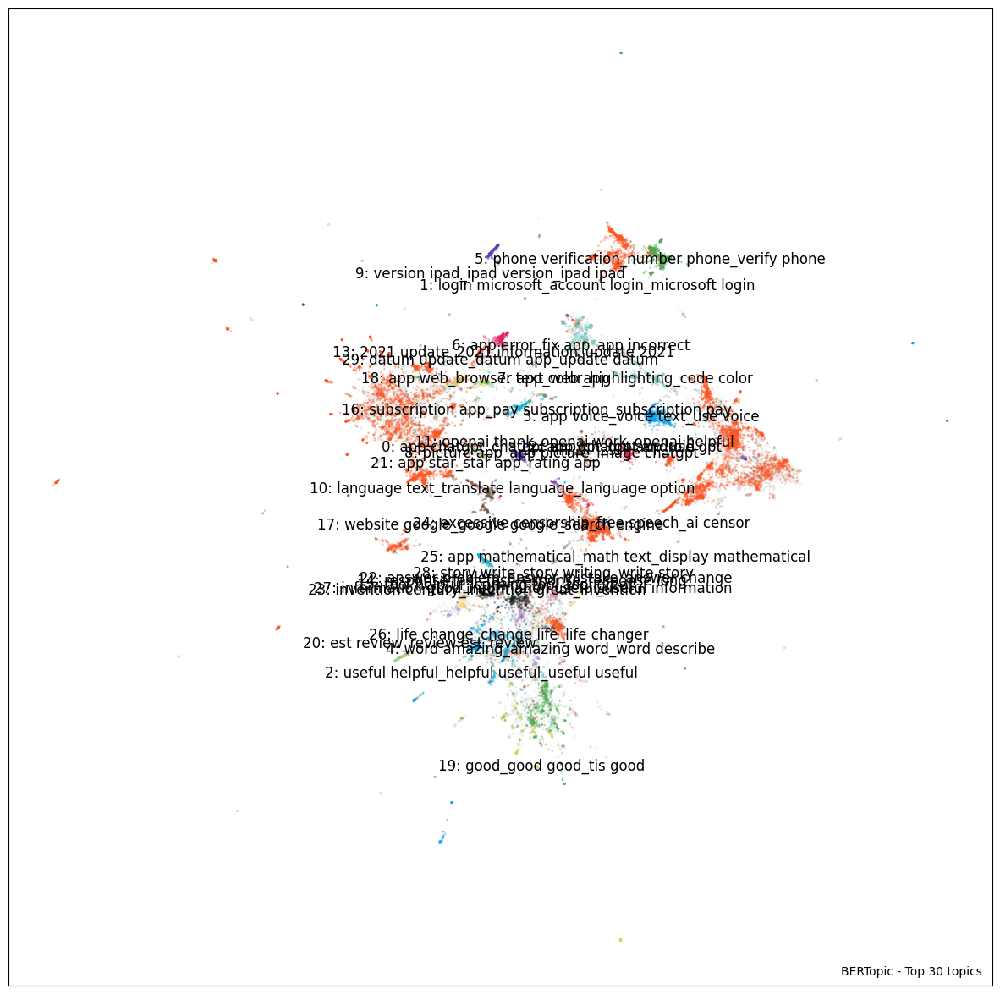

In [ ]:

# import matplotlib
# import matplotlib.pyplot as plt

# %matplotlib inline

# topic_model = BERTopic(embedding_model="paraphrase-MiniLM-L6-v2", verbose=True)
# topics, _ = topic_model.fit_transform(docs)

# # Prepare data for plotting
embeddings = topic_model._extract_embeddings(docs, method="document")
umap_model = UMAP(n_neighbors=10, n_components=2, min_dist=0.0, metric='cosine').fit(embeddings)
df_chart = pd.DataFrame(umap_model.embedding_, columns=["x", "y"])
df_chart["topic"] = topics

# Plot parameters
top_n = 30
fontsize = 12

# Slice data
to_plot = df_chart.copy()
to_plot[df_chart.topic >= top_n] = -1
outliers = to_plot.loc[to_plot.topic == -1]
non_outliers = to_plot.loc[to_plot.topic != -1]

# Visualize topics
cmap = matplotlib.colors.ListedColormap(['#FF5722', # Red
                                         '#03A9F4', # Blue
                                         '#4CAF50', # Green
                                         '#80CBC4', # FFEB3B
                                         '#673AB7', # Purple
                                         '#795548', # Brown
                                         '#E91E63', # Pink
                                         '#212121', # Black
                                         '#00BCD4', # Light Blue
                                         '#CDDC39', # Yellow/Red
                                         '#AED581', # Light Green
                                         '#FFE082', # Light Orange
                                         '#BCAAA4', # Light Brown
                                         '#B39DDB', # Light Purple
                                         '#F48FB1', # Light Pink
                                         ])

# Visualize outliers + inliers
fig, ax = plt.subplots(figsize=(15, 15))
scatter_outliers = ax.scatter(outliers['x'], 
                              outliers['y'], 
                              c="#E0E0E0", 
                              s=1, 
                              alpha=.3)
scatter = ax.scatter(non_outliers['x'], non_outliers['y'], c=non_outliers['topic'], s=1, alpha=.3, cmap=cmap)

# Add topic names to clusters
centroids = to_plot.groupby("topic").mean().reset_index().iloc[1:]
for row in centroids.iterrows():
    topic = int(row[1].topic)
    text = f"{topic}: " + "_".join([x[0] for x in topic_model.get_topic(topic)[:3]])
    ax.text(row[1].x, row[1].y*1.01, text, fontsize=fontsize, horizontalalignment='center')

ax.text(0.99, 0.01, f"BERTopic - Top {top_n} topics", transform=ax.transAxes, horizontalalignment="right", color="black")
plt.xticks([], [])
plt.yticks([], [])
plt.show()

In [ ]:
topic_model.visualize_topics()

## Search topics

Note: You can only use this method if an embedding model was supplied to BERTopic using embedding_model.

In [ ]:
similar_topics, similarity = topic_model.find_topics("voice", top_n=5)
topic_model.get_topic(similar_topics[0])

[('voicetotext', 0.7687919),
 ('voice', 0.64830846),
 ('speechtotext', 0.62790406),
 ('microphone', 0.5031773),
 ('audio', 0.48563433),
 ('speech', 0.46069753),
 ('transcription', 0.45139158),
 ('speaker', 0.41808367),
 ('text', 0.41523013),
 ('speak', 0.40731138)]

## Topics per Class 

### App Rating (positive, neutral, negative)

In [ ]:
topics_per_class = topic_model.topics_per_class(docs, classes=df.score_cat)
fig = topic_model.visualize_topics_per_class(topics_per_class, top_n_topics=15, 
                                      normalize_frequency = True)

fig.write_html('basic.html')
fig.show()

## Timeline / Deep-dive EDA

In [ ]:
#docs = list(df.content.values)
#topic_model = BERTopic()

In [ ]:
df_neg_top15 = df_merged[(df_merged["score_cat"] == "negative") & (df_merged["topic"]< 15)]

In [ ]:
df_negative = df_merged[(df_merged["score_cat"] == "negative") & (df_merged["topic"] == 6)]

In [ ]:
df_negative.columns

Index(['Unnamed: 0', 'reviewId', 'userName', 'content', 'score',
       'thumbsUpCount', 'at', 'replyContent', 'repliedAt', 'appVersion',
       'at_ymd', 'at_q', 'at_ym', 'at_m', 'at_wd', 'score_cat',
       'detected_language', 'topic'],
      dtype='object')

In [ ]:
df_negative['at'] = pd.to_datetime(df_negative['at'])
df_negative['at'].sort_values()

7596    2023-07-25 17:17:30
9591    2023-07-25 17:22:33
2498    2023-07-25 17:37:55
9540    2023-07-25 19:05:41
9346    2023-07-26 06:10:46
                ...        
1174    2023-10-17 12:40:37
1476    2023-10-18 07:36:17
207     2023-10-20 04:01:11
27540   2023-10-21 13:15:15
9520    2023-10-21 15:18:35
Name: at, Length: 83, dtype: datetime64[ns]

In [ ]:
df_negative["week_number"] = df_negative['at'].dt.isocalendar().week

In [ ]:
week_count = df_negative.groupby('week_number')['reviewId'].count().reset_index()
week_count

,week_number,reviewId
0,30,17
1,31,14
2,32,3
3,33,5
4,34,3
5,35,4
6,36,4
7,37,3
8,38,4
9,39,6


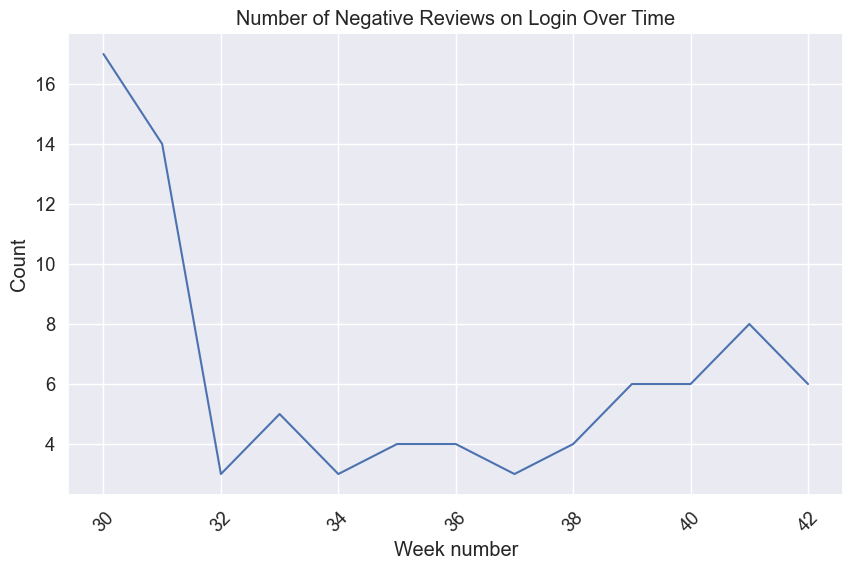

In [ ]:
plt.figure(figsize=(10, 6))
plt.plot(week_count["week_number"], week_count["reviewId"])
plt.xlabel('Week number')
plt.ylabel('Count')
plt.title('Number of Negative Reviews on Login Over Time')
plt.xticks(rotation=45)
plt.grid(True)

plt.show()

[Text(0.5, 0, 'Topic'),
 Text(0, 0.5, 'Count'),
 Text(0.5, 1.0, 'Distribution of Topics')]

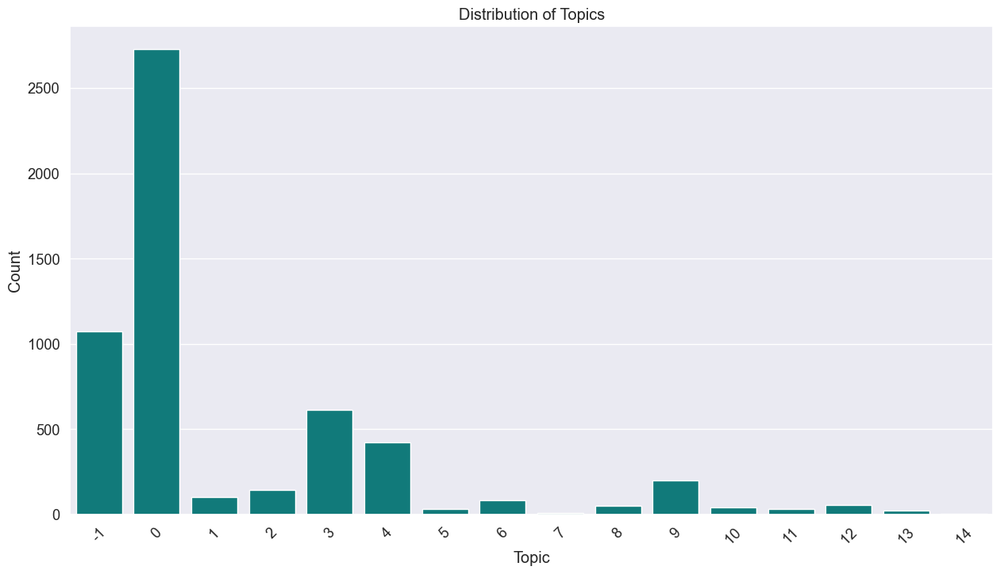

In [ ]:
# Countplot shows the distribution of Publication
plt.rcParams['figure.figsize'] = [15, 8]
sns.set(font_scale = 1.2, style = 'darkgrid')
sns_year = sns.countplot(x=df_neg_top15['topic'], color = 'darkcyan')
plt.xticks(rotation=45)
sns_year.set(xlabel = "Topic", ylabel = "Count", title = "Distribution of Topics")

In [ ]:
sns.lineplot(data=df_negative, x="month", y="passengers")

In [ ]:
topics_per_class = topic_model.topics_per_class(docs, classes=df.at_m)
fig = topic_model.visualize_topics_per_class(topics_per_class, top_n_topics=15, 
                                      normalize_frequency = True)

fig.write_html('basic.html')
fig.show()

ValueError: Expected 2D array, got scalar array instead:
array=nan.
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.

In [ ]:
df.head()

,Unnamed: 0,reviewId,userName,content,score,thumbsUpCount,at,replyContent,repliedAt,appVersion,at_ymd,at_q,at_ym,at_m,at_wd,score_cat,detected_language
0,0,36b7f28e-151d-4b98-8a13-41bd017e0d25,Lin Cheng,chatgpt on android is a solid app with seamles...,4,5,2023-10-19 19:26:19,NaN,NaN,1.2023.284,10/19/23,4,2023-10,October,Thursday,neutral,en
1,1,2bc253b6-c804-47e9-b6f2-3a21027efab4,Alim,i've been using chatgpt for a while but i've j...,5,139,2023-09-29 20:24:38,NaN,NaN,1.2023.263,09/29/23,3,2023-09,September,Friday,positive,en
2,2,5f084727-ab85-40b3-bd42-a7a49502fc1f,Theo Healy,the chatgpt android app has completely blown m...,4,247,2023-07-28 10:29:10,NaN,NaN,1.0.0023,07/28/23,3,2023-07,July,Friday,neutral,en
3,3,5df90de5-b8e2-4dc2-b6ff-520aa3a25eae,Elliot Limberg,no subscription free and accurate unbiased ans...,5,272,2023-07-30 19:38:37,NaN,NaN,1.0.0023,07/30/23,3,2023-07,July,Sunday,positive,en
4,4,bb66c666-865d-4a31-b27f-4933df3ff829,Phoebe Moraes,i use this app for learning languages which ch...,4,126,2023-08-09 18:23:33,NaN,NaN,1.0.0030,08/09/23,3,2023-08,August,Wednesday,neutral,en


Summary: 
- Bugs with login, other errors  
- Educational purpose, studying 
- Helping, Assistance 
- Phone number for registration needed, verification
- Feature request on uploading photos, gettung responses with images 
- Translation problems for hindi speakers 
- future-oriented topic

## Dealing with Outliers

-1 represents outliers: 6841! 

In [ ]:
percentage_outliers = (6841 / 22371)*100 
percentage_outliers

30.579768450225735

Four different strategies to deal with the outliers:
1. based on topic-document probabilities,
2. based on topic distributions,
3. based on c-TF-IFD representations,
4. based on document and topic embeddings.

## Reducing the number of topics

In [ ]:
topic_model.visualize_heatmap(n_clusters = 20)

In [ ]:
distance_matrix = cosine_similarity(np.array(topic_model.topic_embeddings_))
dist_df = pd.DataFrame(distance_matrix, columns=topic_model.topic_labels_.values(), 
                       index=topic_model.topic_labels_.values())

tmp = []
for rec in dist_df.reset_index().to_dict('records'):
    t1 = rec['index']
    for t2 in rec:
        if t2 == 'index': 
            continue
        tmp.append(
            {
                'topic1': t1, 
                'topic2': t2, 
                'distance': rec[t2]
            }
        )

pair_dist_df = pd.DataFrame(tmp)

pair_dist_df = pair_dist_df[(pair_dist_df.topic1.map(
      lambda x: not x.startswith('-1'))) & 
            (pair_dist_df.topic2.map(lambda x: not x.startswith('-1')))]
pair_dist_df = pair_dist_df[pair_dist_df.topic1 < pair_dist_df.topic2]
pair_dist_df.sort_values('distance', ascending = False).head(20)

,topic1,topic2,distance
40635,200_android_app_native_phone,32_android_mobile_finally_os,0.887677
9373,45_review_reviewer_follow_complaint,80_review_reviewer_rating_thank,0.887035
28134,138_use_easy_simple_easily,55_useful_use_practical_handy,0.885001
377,0_app_application_use_download,174_app_experience_use_wonderful,0.878171
346,0_app_application_use_download,143_app_interesting_neat_curious,0.869638
426,1_chatgpt_conversation_conversational_chat,21_chatgpt_openai_chat_android,0.855959
22378,109_grammar_grammatical_editing_speech,157_app_language_application_translation,0.854126
4889,23_app_2021_2023_currentupdate,40_app_improvement_improve_appian,0.853135
27043,132_chatgpt_chatgpts_login_unable,176_chatgpt_unable_error_wifi,0.851943
3677,17_app_webview_mobile_version,40_app_improvement_improve_appian,0.850428


### Merging

Intentionally left blank as we should take a deeper look into the clusters to see what can be merged

In [ ]:
#topic_model.merge_topics(docs, [[26, 74], [43, 68, 62], [16, 50, 91]])
#df['merged_topic'] = topic_model.topics_

## Topic Distributions

In [ ]:
topic_distr, topic_token_distr = topic_model.approximate_distribution(
      docs, window = 4, calculate_tokens=True)

In [ ]:
topic_model.visualize_distribution(topic_distr[1])

In [ ]:
# Calculate the topic distributions on a token-level
topic_distr, topic_token_distr = topic_model.approximate_distribution(docs, calculate_tokens=True)

# Visualize the token-level distributions
df = topic_model.visualize_approximate_distribution(docs[1], topic_token_distr[1])
df

,have,be,use,chatgpt,for,while,but,have,just,test,out,the,microphone,speech,recognition,option,for,the,first,time,and,let,we,say,be,completely,blow,away,no,seriously,it,literally,put,all,the,expression,punctuation,in,the,right,place,no,matter,how,you,talk,it,convert,it,without,problem,it,be,amazing,and,will,probably,will,never,type,to,chatgpt,again,still,though,that,be,some,outstanding,work,now,we,wait,for,voice,response,from,the,both,hopefully
0_app_application_use_download,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.139,0.314,0.489,0.489,0.350,0.175,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
1_chatgpt_conversation_conversational_chat,0.205,0.410,0.614,0.863,0.658,0.453,0.248,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.248,0.497,0.497,0.497,0.248,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.106,0.106,0.106,0.106,0.000
3_awesome_hopefully_hype_wanna,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.139,0.397,0.655,0.655,0.516,0.258,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
5_login_password_reinstall_unable,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.137,0.273,0.410,0.547,0.410,0.273,0.137,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
6_voicetotext_voice_speechtotext_microphone,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.225,0.503,0.794,1.118,1.077,0.798,0.508,0.184,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.443,0.877,1.430,1.982,1.539,1.105,0.553,0.000,0.000
10_answer_reply_question_ask,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.110,0.110,0.110,0.110,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
12_image_photo_pic_picture,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.129,0.129,0.129,0.129,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,

TO-DO: 

- append topic names to df 
- merge similar topics
